## Exploratory data analysis EDA

In [2]:
# importe libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import math

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from IPython.display import clear_output

from sklearn import model_selection, preprocessing, linear_model, metrics

In [3]:
adult_census_data = pd.read_csv("datasets/adult_census_income/adult.data")

In [4]:
# existen 32560 ejemplos con 15 caracteristicas
adult_census_data.shape

(32560, 15)

In [5]:
#tipos de datos y cuanto muestras exiten
pd.value_counts(adult_census_data.dtypes)

object    9
int64     6
dtype: int64

In [6]:
adult_census_data.columns = [
    "age",
    "workclass", 
    "fnlwgt",
    "education",
    "education.num",
    "marital.status",
    "occupation",
    "relationship",
    "race",
    "sex",
    "capital.gain",
    "capital.loss",
    "hours.per.week",
    "native.country",
    "income"
]

In [7]:
adult_census_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32560 entries, 0 to 32559
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32560 non-null  int64 
 1   workclass       32560 non-null  object
 2   fnlwgt          32560 non-null  int64 
 3   education       32560 non-null  object
 4   education.num   32560 non-null  int64 
 5   marital.status  32560 non-null  object
 6   occupation      32560 non-null  object
 7   relationship    32560 non-null  object
 8   race            32560 non-null  object
 9   sex             32560 non-null  object
 10  capital.gain    32560 non-null  int64 
 11  capital.loss    32560 non-null  int64 
 12  hours.per.week  32560 non-null  int64 
 13  native.country  32560 non-null  object
 14  income          32560 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [8]:
adult_census_data.head()

,age,workclass,fnlwgt,education,education.num,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
0,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
1,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
3,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
4,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K


### Cleaning data

In [9]:
fig = make_subplots(
    rows=1, 
    cols=2,
    subplot_titles=(
        "Null value ratio columns wise",
        "Heat map for null values (0->NotNull & 1->Null)"
    )
)
data_with_nans = adult_census_data.isna()
data_with_nans_mean = data_with_nans.mean().sort_values()

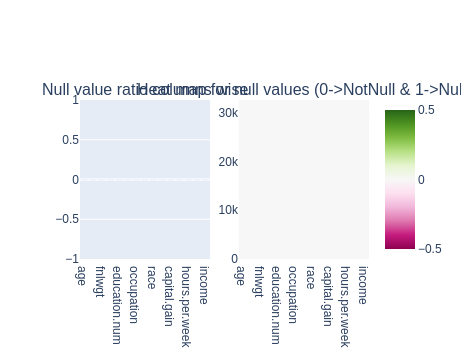

In [10]:
fig.add_trace(
    go.Bar(x=data_with_nans_mean.index, y=data_with_nans_mean.values),
    row=1,
    col=1
)

fig.add_trace(
    px.imshow(
        data_with_nans.astype(np.int8)
    ).data[0],
    row=1,
    col=2
)

fig.update_layout(showlegend=False)
fig.show()

In [11]:
# valores unicos cuantos hay
adult_census_data.nunique()

age                  73
workclass             9
fnlwgt            21647
education            16
education.num        16
marital.status        7
occupation           15
relationship          6
race                  5
sex                   2
capital.gain        119
capital.loss         92
hours.per.week       94
native.country       42
income                2
dtype: int64

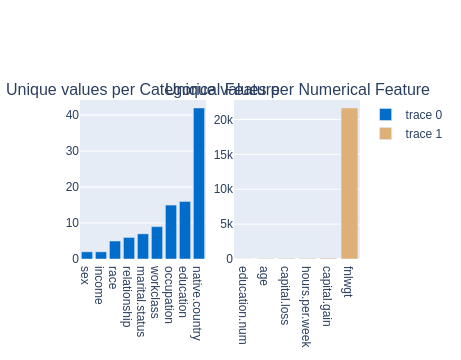

In [12]:
fig = make_subplots(
    rows=1,
    cols=2,
    subplot_titles = (
        "Unique values per Categorical Feature",
        "Unique values per Numerical Feature"
    )
)

only_data_catg = adult_census_data.select_dtypes(exclude="number").nunique().sort_values()

fig.add_trace(
    go.Bar(
        x=only_data_catg.index, 
        y=only_data_catg.values,
        marker=dict(color="#016CC9")),
    row = 1,
    col = 1
)

only_data_numb = adult_census_data.select_dtypes(include="number").nunique().sort_values()

fig.add_trace(
    go.Bar(
        x=only_data_numb.index, 
        y=only_data_numb.values,
        marker=dict(color="#DEB078")),
    row = 1,
    col = 2
)

fig.show()

### Value Behaviour

In [13]:
adult_census_data.age.head(10)

0    50
1    38
2    53
3    28
4    37
5    49
6    52
7    31
8    42
9    37
Name: age, dtype: int64

In [14]:
#el numero de horas de trabajo lo trataremos como str
adult_census_data[["education.num"]] = adult_census_data[["education.num"]].astype("str")

### Univariate Analysis 

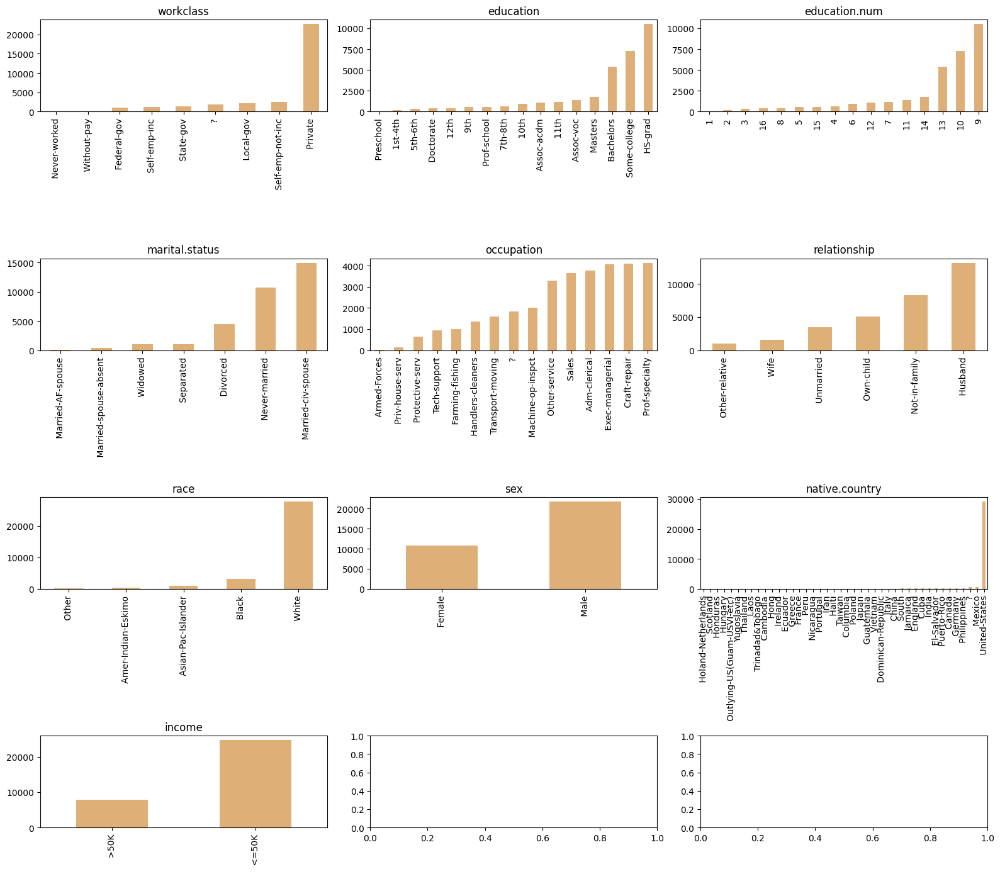

In [15]:
# select_dtype selecciona solo los tipos de datos (nombre de columna) que sean categoricas

# the most workclass is private
# the education with more samples is HS-grad and Some-College
# the number of education years is 10 an 9 years
# the common marital status Never-married or Married with spouse
# the common occupation Exec-managerial, craft repair, prof-speciality
# the relationship is not in family and husband so there more man
# the common race is white, at this time this feature is not valuable for the census 
# (great companies has CEO from differents countries) without matter the race
# the common sex is male (it is understandable because the census is from 1996)
# so women got a few jobs at this time, but currently women has same jobs as men
# native_country obviosuly the census is from US so most of people are from US
# the common income is <= 50K


only_data_catg = adult_census_data.select_dtypes(exclude="number").columns
figuresize=(16,14)
cols = 3
rows = math.ceil(len(only_data_catg)/cols)
#que genial plot
#first is subplots then is only a subplot
plt.subplots(rows,cols,figsize=figuresize)
for i in range(0,len(only_data_catg)):
    plt.subplot(rows, cols, i+1)
    adult_census_data[only_data_catg[i]].value_counts().sort_values().plot.bar(color="#DEB078")
    plt.xticks(rotation=90)
    plt.title(only_data_catg[i])
#ayuda que las labels de x se muestren completamente
plt.tight_layout()
plt.show()

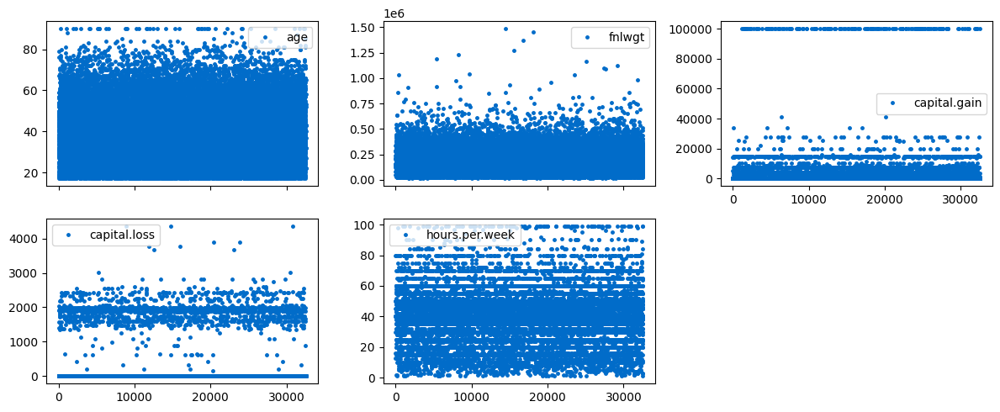

In [16]:
# For all numerical column for all rows

# todos evaluados con 32560 registros 
# al ser muchos registros se muestras los datos cercanos el uno con el otro en las columnas
# podras observar donde hay mas acumulacion dependiendo del intervalo de fila que observes

# en edad hay de 18 a 70 años los de 80 ya son dispersos
# en finalweight mas es de [0.0, 0.5] despues es disperso
# en numero de anios de educacion es equilibrado de [5.0 a 15.0] pero menos de 2.5 es disperso
# en capital de ganancia es 100_000 y menos de 20_000 es mas frecuente
# en perdida en capital es mas frecuente de [[1500,2_000]
# en horas de trabajo es mas frecuente de 40 a 60 horas
adult_census_data.plot(
    lw=0, 
    marker=".",
    subplots=True,
    layout=(-1,3),
    figsize=(12,5),
    markersize=5,
    color="#016CC9"
)
plt.tight_layout()

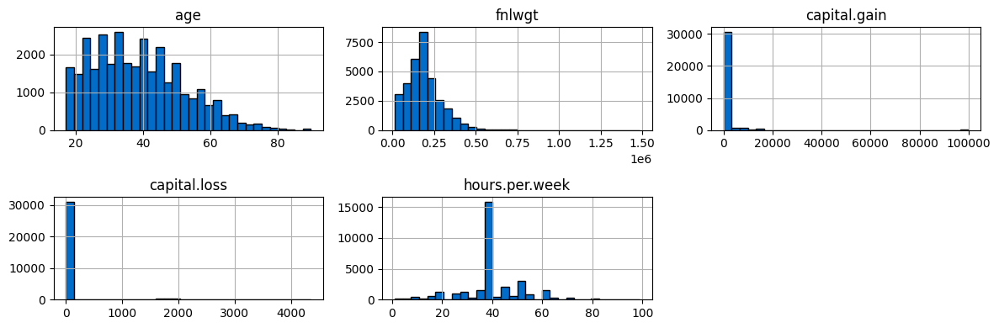

In [17]:
### For numerical data
### this is a resume prom the previous plot
figsize_val = (12,4)
layout_val = (-1,3)
#hist only take numerical data
adult_census_data.hist(
    bins=30, 
    figsize=figsize_val, 
    layout=layout_val,
    edgecolor="black",
    color="#016CC9"
)
plt.tight_layout()

###  skewness 
- is a measure of the asymmetry of the probability distribution of a real-valued random variable about its mean. The skewness value can be positive, zero, negative, or undefined.

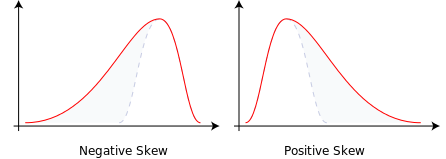

In [18]:
adult_census_data.select_dtypes(include="number").skew()
#edad + skew 0.5 mas cumulo de datos poca cola
#fnlwgt + skew 1.4 menos cumulo gran cola
#capital.gain + skew 11.9 poco cumulo enorme cola
#capital.loss + skew 4.6 poquisimo cumulo enorme cola
#hours.per.week + skew 0.22 casi equilibrado centrado en 40 hours

age                0.558738
fnlwgt             1.446972
capital.gain      11.953690
capital.loss       4.594549
hours.per.week     0.227636
dtype: float64

In [19]:
list_data_num = (adult_census_data.select_dtypes(include="number").columns).to_list()

adult_data_num = adult_census_data[list_data_num]
adult_data_num.head()

,age,fnlwgt,capital.gain,capital.loss,hours.per.week
0,50,83311,0,0,13
1,38,215646,0,0,40
2,53,234721,0,0,40
3,28,338409,0,0,40
4,37,284582,0,0,40


In [20]:
upper = adult_data_num.quantile(0.75) + 1.5*(adult_data_num.quantile(0.75) - adult_data_num.quantile(0.45))
lower = adult_data_num.quantile(0.45) - 1.5*(adult_data_num.quantile(0.75) - adult_data_num.quantile(0.45))

# we have quantile 75% limite superior
# we have quantile 25% limite inferior
# in every number feature
print(lower,"\n",upper)
# si salen fueran de estos limites se les considera outliers

age                  15.50
fnlwgt            68158.25
capital.gain          0.00
capital.loss          0.00
hours.per.week       32.50
dtype: float64 
 age                   67.50
fnlwgt            338392.25
capital.gain           0.00
capital.loss           0.00
hours.per.week        52.50
dtype: float64


In [21]:
for i in list_data_num:
    print("\nColumn -> " , i , "")
    x = adult_data_num[(adult_data_num[i] < round(lower[i], 2)) |
                       (adult_data_num[i] > round(upper[i], 2))
                      ][i].to_list()
    print("No of Outliers present -> ", len(x))
    print("\n","*"*10)


Column ->  age 
No of Outliers present ->  857

 **********

Column ->  fnlwgt 
No of Outliers present ->  6290

 **********

Column ->  capital.gain 
No of Outliers present ->  2711

 **********

Column ->  capital.loss 
No of Outliers present ->  1519

 **********

Column ->  hours.per.week 
No of Outliers present ->  9008

 **********


### Target Variable

In [22]:
#Normaliza in order to divide by the total and then get the percentage
adult_census_data[["income"]].value_counts(normalize=True).round(decimals=3)*100
#el 76% es para menores de 50k
#el 24% es para mayores de 50k

income
 <=50K    75.9
 >50K     24.1
dtype: float64

In [23]:
temp_layout = dict(layout=go.Layout(font=dict(family="Franklin Gothic", size=12),
                            height=500, width=1000))

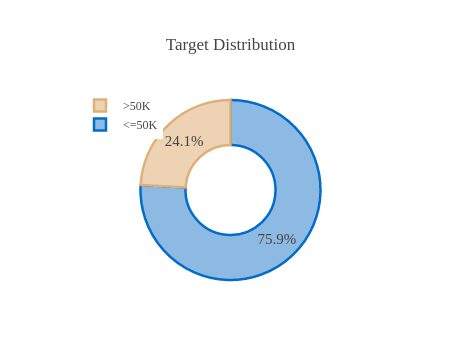

In [24]:
incomes_norm = adult_census_data[["income"]].value_counts(normalize=True).round(decimals=3)*100
pal, color = ['#016CC9','#DEB078'], ['#8DBAE2','#EDD3B3']
fig = go.Figure()

fig.add_trace(go.Pie(labels=incomes_norm.index, values=incomes_norm, hole=.5,
                    showlegend=True, sort=False,
                    marker=dict(colors=color,line=dict(color=pal, width=2.5)),
                    hovertemplate = "%{label} Income: %{value:.2f}%<extra></extra>"
                    ))

fig.update_layout(
    template=temp_layout, title="Target Distribution",
    legend=dict(traceorder="reversed", y=1.05, x=0),
    uniformtext_minsize=15, 
    uniformtext_mode="hide", 
    width=700
)
fig.show()

### Multivariate Analysis

In [81]:
### Relation categoical vaiables with target variable
# Todos menos el ultimo
adult_census_data.select_dtypes(exclude="number").columns[:-1]

Index(['workclass', 'education', 'education.num', 'marital.status',
       'occupation', 'relationship', 'race', 'sex', 'native.country'],
      dtype='object')

In [87]:
# helping function to get % fo categories and overall

#por default toda columna nueva es nombrada a partir de cero
#el value counts puede combinar 2 columnas a la vez
# el income seria las 2 posibilidades <50 >=50 combinado con la columna deseada
# y el resultado se puede dar en porcentaje al normalizar

#el grouby toma los valores repetido y crea un cruzamiento con este
#el reset index con atributo name renombar la columna con la data size

#pivot hace el cruzamiento 
# columna deseada como columna y como indice income
def stats_with_income(x):
    
    conteo_with_income = (adult_census_data[[x,"income"]].value_counts(normalize=True).round(decimals=3)*100).reset_index().rename(columns={0:"overall_percent"})
    
    column_to_aggregate = [x,"income"]
    #el primero es tamanios del columna con el income combinado
    #el segundo solo es el tamanio de la columna deseada
    #aplica merge sobre ellos sobre la columna deseada
    #repetira la columna deseada por cada income (por poseer el total)
    
    datasize_with_income = pd.merge(
        adult_census_data.groupby(column_to_aggregate).size().reset_index(name="ind_siz"),
        adult_census_data.groupby(column_to_aggregate[:-1]).size().reset_index(name="total"), 
        on=column_to_aggregate[:-1]
    )
    #necesitas de ind_size y total para el category percent
    #workclass  income  (ind_size  total)  category_percent
    datasize_with_income["category_percent"] = round((datasize_with_income["ind_siz"] / datasize_with_income["total"])*100,2)
    #workclass  income  category_percent
    only_percentage = datasize_with_income[[x,"income","category_percent"]]
    #[workclass  income]  overall_percent category_percent
    all_percentage_income = conteo_with_income.merge(only_percentage, on=[x,"income"])
    
    return all_percentage_income.pivot(columns="income", index=x)


In [88]:
stats_with_income("workclass")

overall_percent       category_percent       
income                      <=50K  >50K            <=50K   >50K
workclass                                                      
 ?                            5.1   0.6            89.60  10.40
 Federal-gov                  1.8   1.1            61.35  38.65
 Local-gov                    4.5   1.9            70.52  29.48
 Never-worked                 0.0   NaN           100.00    NaN
 Private                     54.5  15.2            78.13  21.87
 Self-emp-inc                 1.5   1.9            44.27  55.73
 Self-emp-not-inc             5.6   2.2            71.51  28.49
 State-gov                    2.9   1.1            72.78  27.22
 Without-pay                  0.0   NaN           100.00    NaN

In [90]:
stats_with_income("education")

overall_percent       category_percent       
income                  <=50K  >50K            <=50K   >50K
education                                                  
 10th                     2.7   0.2            93.35   6.65
 11th                     3.4   0.2            94.89   5.11
 12th                     1.2   0.1            92.38   7.62
 1st-4th                  0.5   0.0            96.43   3.57
 5th-6th                  1.0   0.0            95.20   4.80
 7th-8th                  1.9   0.1            93.81   6.19
 9th                      1.5   0.1            94.75   5.25
 Assoc-acdm               2.5   0.8            75.16  24.84
 Assoc-voc                3.1   1.1            73.88  26.12
 Bachelors                9.6   6.8            58.52  41.48
 Doctorate                0.3   0.9            25.91  74.09
 HS-grad                 27.1   5.1            84.05  15.95
 Masters                  2.3   2.9            44.34  55.66
 Preschool                0.2   NaN           100.00    NaN
 Prof-school              0.5   1.3            26.56  73.44
 Some-college            18.1   4.3            80.98  19.02

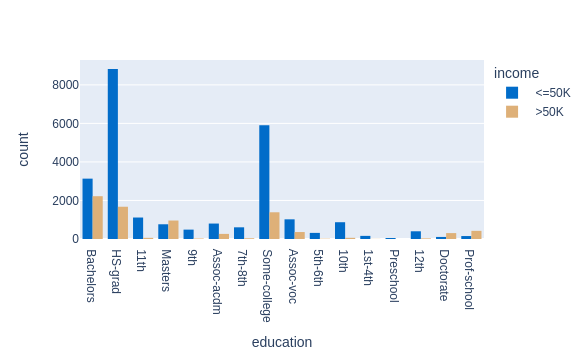

In [91]:
px.histogram(adult_census_data, x="education", color="income", barmode="group", color_discrete_sequence=['#016CC9','#DEB078'])

In [93]:
stats_with_income("education.num")

overall_percent       category_percent       
income                  <=50K  >50K            <=50K   >50K
education.num                                              
1                         0.2   NaN           100.00    NaN
10                       18.1   4.3            80.98  19.02
11                        3.1   1.1            73.88  26.12
12                        2.5   0.8            75.16  24.84
13                        9.6   6.8            58.52  41.48
14                        2.3   2.9            44.34  55.66
15                        0.5   1.3            26.56  73.44
16                        0.3   0.9            25.91  74.09
2                         0.5   0.0            96.43   3.57
3                         1.0   0.0            95.20   4.80
4                         1.9   0.1            93.81   6.19
5                         1.5   0.1            94.75   5.25
6                         2.7   0.2            93.35   6.65
7                         3.4   0.2            94.89   5.11
8                         1.2   0.1            92.38   7.62
9                        27.1   5.1            84.05  15.95

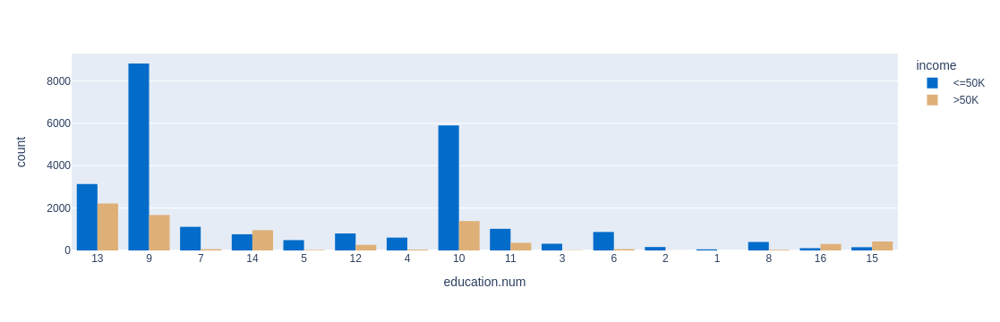

In [92]:
px.histogram(adult_census_data, x="education.num", color="income", barmode="group", color_discrete_sequence=['#016CC9','#DEB078'])

In [94]:
stats_with_income("marital.status")

overall_percent       category_percent       
income                           <=50K  >50K            <=50K   >50K
marital.status                                                      
 Divorced                         12.2   1.4            89.58  10.42
 Married-AF-spouse                 0.0   0.0            56.52  43.48
 Married-civ-spouse               25.4  20.6            55.32  44.68
 Married-spouse-absent             1.2   0.1            91.87   8.13
 Never-married                    31.3   1.5            95.40   4.60
 Separated                         2.9   0.2            93.56   6.44
 Widowed                           2.8   0.3            91.44   8.56

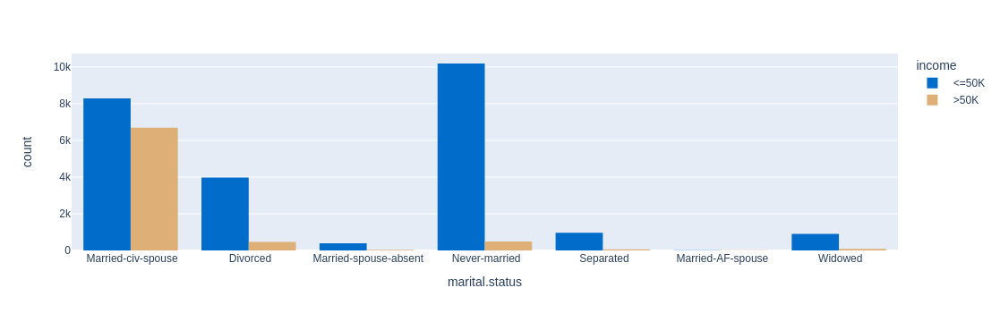

In [95]:
px.histogram(adult_census_data, x="marital.status", color="income", barmode="group", color_discrete_sequence=['#016CC9','#DEB078'])

In [97]:
stats_with_income("occupation")

overall_percent       category_percent       
income                       <=50K  >50K            <=50K   >50K
occupation                                                      
 ?                             5.1   0.6            89.64  10.36
 Adm-clerical                 10.0   1.6            86.55  13.45
 Armed-Forces                  0.0   0.0            88.89  11.11
 Craft-repair                  9.7   2.9            77.34  22.66
 Exec-managerial               6.4   6.0            51.60  48.40
 Farming-fishing               2.7   0.4            88.43  11.57
 Handlers-cleaners             3.9   0.3            93.72   6.28
 Machine-op-inspct             5.4   0.8            87.51  12.49
 Other-service                 9.7   0.4            95.84   4.16
 Priv-house-serv               0.5   0.0            99.33   0.67
 Prof-specialty                7.0   5.7            55.10  44.90
 Protective-serv               1.3   0.6            67.49  32.51
 Sales                         8.2   3.0            73.07  26.93
 Tech-support                  2.0   0.9            69.50  30.50
 Transport-moving              3.9   1.0            79.96  20.04

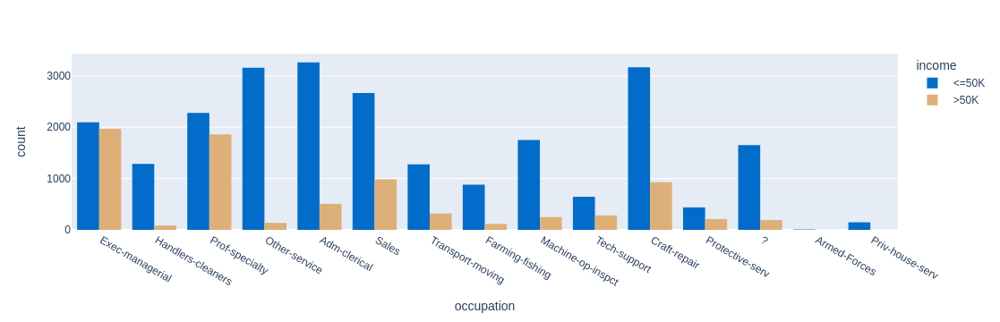

In [98]:
px.histogram(adult_census_data, x="occupation", color="income", barmode="group", color_discrete_sequence=['#016CC9','#DEB078'])

In [99]:
stats_with_income("relationship")

overall_percent       category_percent       
income                    <=50K  >50K            <=50K   >50K
relationship                                                 
 Husband                   22.3  18.2            55.14  44.86
 Not-in-family             22.9   2.6            89.69  10.31
 Other-relative             2.9   0.1            96.23   3.77
 Own-child                 15.4   0.2            98.68   1.32
 Unmarried                  9.9   0.7            93.67   6.33
 Wife                       2.5   2.3            52.49  47.51

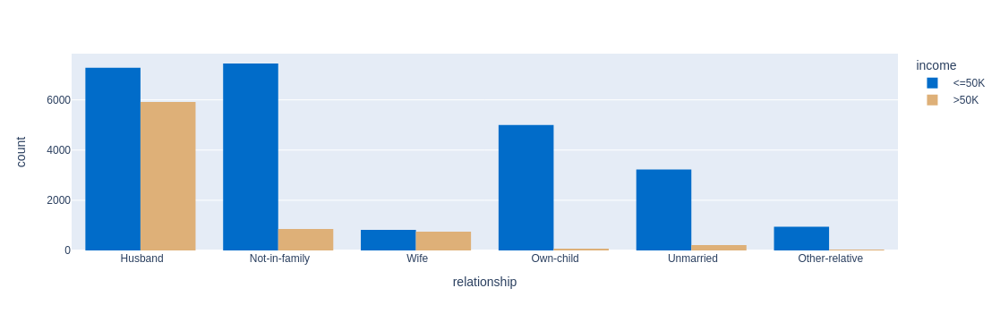

In [100]:
px.histogram(adult_census_data, x="relationship", color="income", barmode="group", color_discrete_sequence=['#016CC9','#DEB078'])

In [101]:
stats_with_income("race")

overall_percent       category_percent       
income                        <=50K  >50K            <=50K   >50K
race                                                             
 Amer-Indian-Eskimo             0.8   0.1            88.42  11.58
 Asian-Pac-Islander             2.3   0.8            73.44  26.56
 Black                          8.4   1.2            87.61  12.39
 Other                          0.8   0.1            90.77   9.23
 White                         63.6  21.9            74.41  25.59

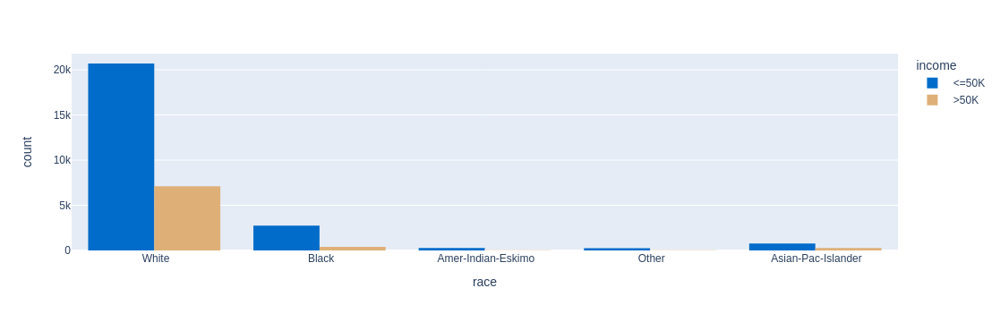

In [102]:
px.histogram(adult_census_data, x='race', color="income", barmode='group',color_discrete_sequence=['#016CC9','#DEB078'])

In [103]:
stats_with_income("sex")

overall_percent       category_percent       
income            <=50K  >50K            <=50K   >50K
sex                                                  
 Female            29.5   3.6            89.05  10.95
 Male              46.5  20.5            69.42  30.58

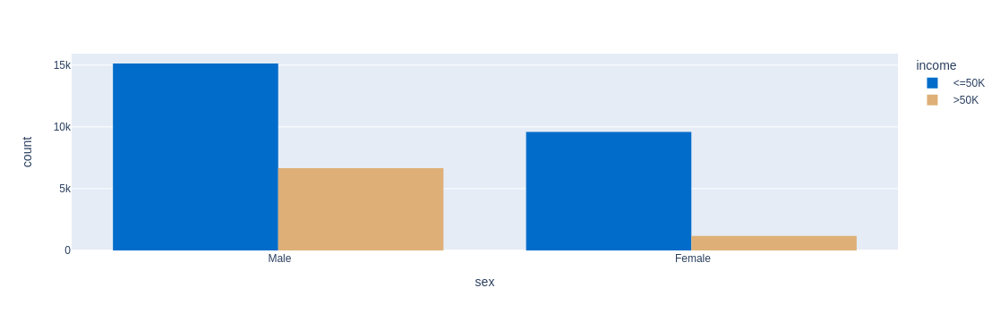

In [104]:
px.histogram(adult_census_data, x='sex', color="income", barmode='group',color_discrete_sequence=['#016CC9','#DEB078'])

In [106]:
stats_with_income("native.country")

overall_percent       category_percent       
income                                <=50K  >50K            <=50K   >50K
native.country                                                           
 ?                                      1.3   0.4            74.96  25.04
 Cambodia                               0.0   0.0            63.16  36.84
 Canada                                 0.3   0.1            67.77  32.23
 China                                  0.2   0.1            73.33  26.67
 Columbia                               0.2   0.0            96.61   3.39
 Cuba                                   0.2   0.1            73.68  26.32
 Dominican-Republic                     0.2   0.0            97.14   2.86
 Ecuador                                0.1   0.0            85.71  14.29
 El-Salvador                            0.3   0.0            91.51   8.49
 England                                0.2   0.1            66.67  33.33
 France                                 0.1   0.0            58.62  41.38
 Germany                                0.3   0.1            67.88  32.12
 Greece                                 0.1   0.0            72.41  27.59
 Guatemala                              0.2   0.0            95.31   4.69
 Haiti                                  0.1   0.0            90.91   9.09
 Holand-Netherlands                     0.0   NaN           100.00    NaN
 Honduras                               0.0   0.0            92.31   7.69
 Hong                                   0.0   0.0            70.00  30.00
 Hungary                                0.0   0.0            76.92  23.08
 India                                  0.2   0.1            60.00  40.00
 Iran                                   0.1   0.1            58.14  41.86
 Ireland                                0.1   0.0            79.17  20.83
 Italy                                  0.1   0.1            65.75  34.25
 Jamaica                                0.2   0.0            87.65  12.35
 Japan                                  0.1   0.1            61.29  38.71
 Laos                                   0.0   0.0            88.89  11.11
 Mexico                                 1.9   0.1            94.87   5.13
 Nicaragua                              0.1   0.0            94.12   5.88
 Outlying-US(Guam-USVI-etc)             0.0   NaN           100.00    NaN
 Peru                                   0.1   0.0            93.55   6.45
 Philippines                            0.4   0.2            69.19  30.81
 Poland                                 0.1   0.0            80.00  20.00
 Portugal                               0.1   0.0            89.19  10.81
 Puerto-Rico                            0.3   0.0            89.47  10.53
 Scotland                               0.0   0.0            75.00  25.00
 South                                  0.2   0.0            80.00  20.00
 Taiwan                                 0.1   0.1            60.78  39.22
 Thailand                               0.0   0.0            83.33  16.67
 Trinadad&Tobago                        0.1   0.0            89.47  10.53
 United-States                         67.6  22.0            75.42  24.58
 Vietnam                                0.2   0.0            92.54   7.46
 Yugoslavia                             0.0   0.0            62.50  37.50

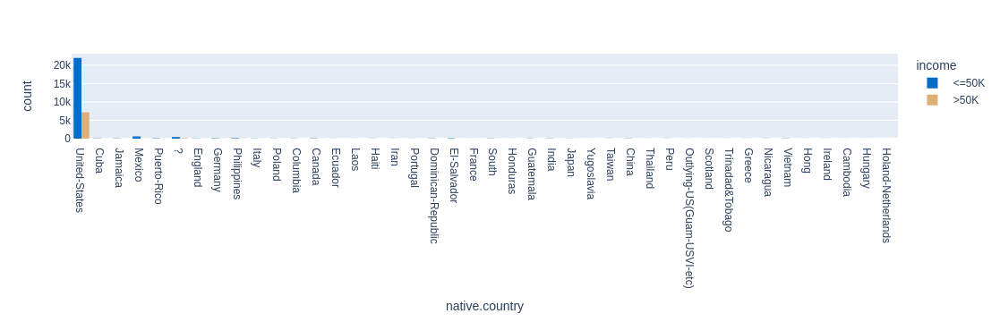

In [107]:
px.histogram(adult_census_data, x='native.country', color="income", barmode='group',color_discrete_sequence=['#016CC9','#DEB078'])

### Numerical vaiablees relation with target (income)

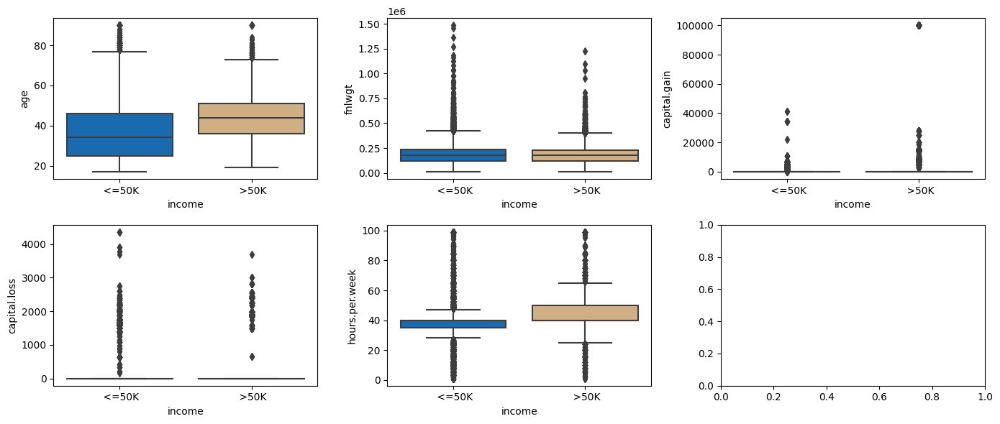

In [111]:
adult_num_data_cols = adult_census_data.select_dtypes(include="number").columns.to_list()
adult_num_data_cols.append("income")
# numerical columns + target = 6
num_cols_plot = 3
num_rows_plot = math.ceil((len(adult_num_data_cols)-1)/num_cols_plot) # -> 2
# 2 * 3
plt.subplots(num_rows_plot,num_cols_plot,figsize=(14,6))

for i in range(1,len(adult_num_data_cols)):
    plt.subplot(x,y,i)
    sns.boxplot(data=adult_census_data, y=adult_num_data_cols[i-1], x="income", palette=['#016CC9','#DEB078'])
plt.tight_layout()
plt.show()

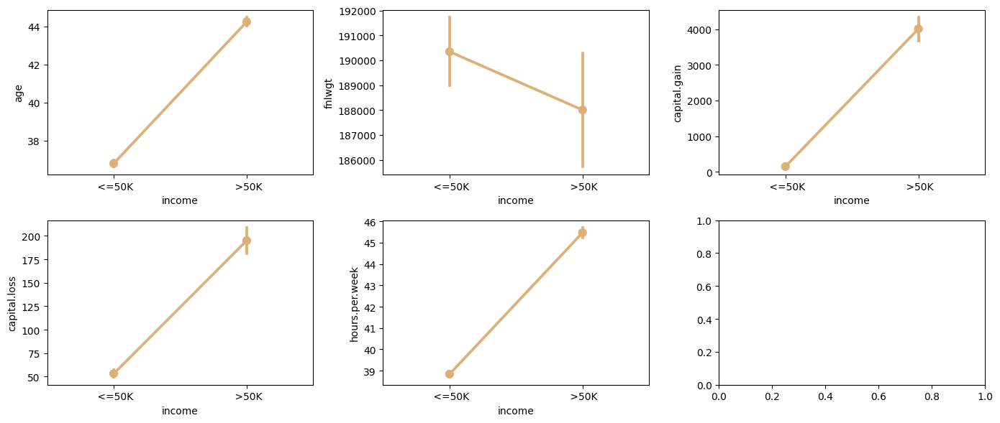

In [112]:
##pointplot
#A point plot represents an estimate of central tendency for a numeric variable by the position of the dot 
# and provides some indication of the uncertainty around that estimate using error bars
adult_num_data_cols = adult_census_data.select_dtypes(include="number").columns.to_list()
adult_num_data_cols.append("income")
# numerical columns + target = 6
num_cols_plot = 3
num_rows_plot = math.ceil((len(adult_num_data_cols)-1)/num_cols_plot) # -> 2

plt.subplots(num_rows_plot,num_cols_plot,figsize=(14,6))

for i in range(1,len(adult_num_data_cols)):
    plt.subplot(x,y,i)
    sns.pointplot(data=adult_census_data, y=adult_num_data_cols[i-1], x="income", color='#DEB078')
plt.tight_layout()
plt.show()


### Other relationships

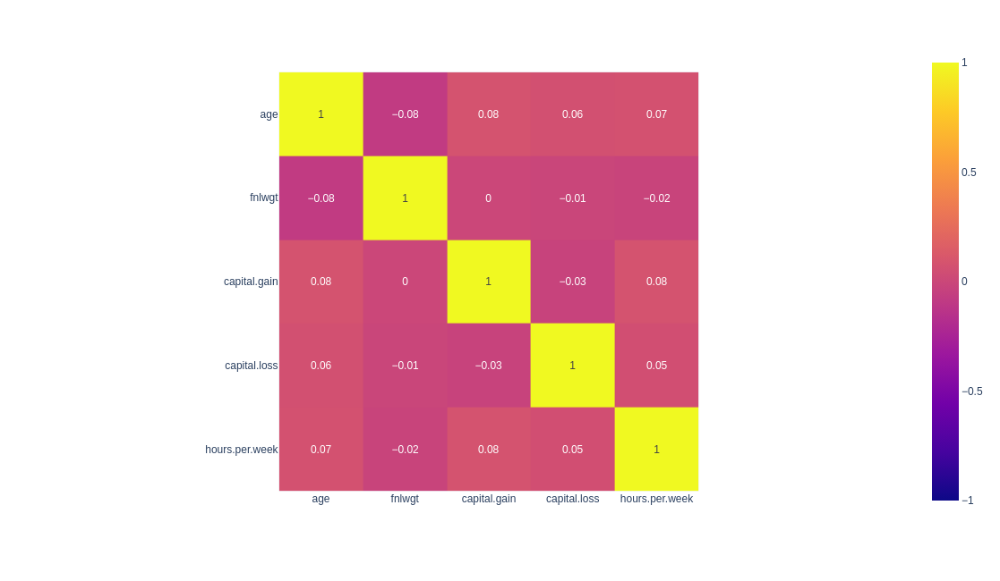

In [115]:
fig = px.imshow(
    adult_census_data.select_dtypes(include="number").corr().round(2), 
    zmin=-1, 
    zmax=1, 
    text_auto=True, 
    width=1200,
    height=650,
    aspect=None
)

fig.show()

#No relationships among variable ojo  todos tiene una cercania a cero

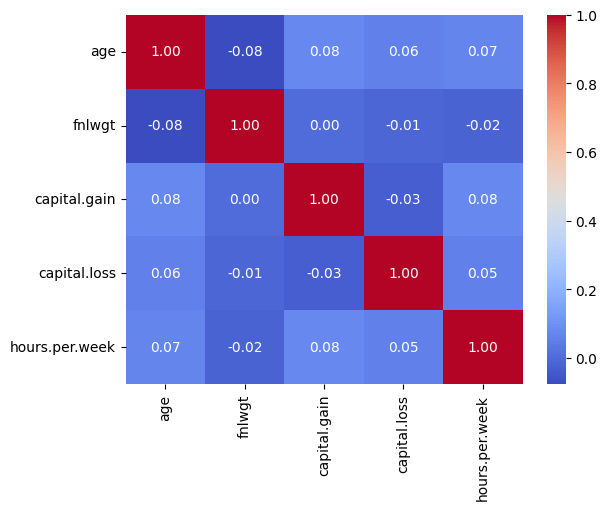

In [119]:
sns.heatmap(
    adult_census_data.select_dtypes(include="number").corr(),
    annot=True,
    fmt=".2f",
    cmap="coolwarm"
)
plt.show()